In [1]:
#dependencies
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
from matplotlib.lines import Line2D

In [2]:
#reading in the state abbreviations
path = '../statesAbbrev.csv'
statesAbbrev_df = pd.read_csv(path)
statesAbbrev_df.head(20)

,State,Abbrev,Code
0,Alabama,Ala.,AL
1,Alaska,Alaska,AK
2,Arizona,Ariz.,AZ
3,Arkansas,Ark.,AR
4,California,Calif.,CA
5,Colorado,Colo.,CO
6,Connecticut,Conn.,CT
7,Delaware,Del.,DE
8,District of Columbia,D.C.,DC
9,Florida,Fla.,FL


In [3]:
#list for state codes
state_codes = [x for x in statesAbbrev_df['Code']]

In [5]:
#list for state names
state_names = [x for x in statesAbbrev_df['State']]

In [6]:
#creating lowercase no space state names appropriate for file names
state_names_for_files = [x.lower().replace(" ", "_") for x in state_names]

In [7]:
#creating a df dict to hold the state dfs, reading in the dfs
states_df_dict = {}
for x in range(10, 20):
    path = f'../states_data/US-{state_codes[x]}_cat_data.csv'
    states_df_dict[f'{state_codes[x]}_data_df'] = [pd.read_csv(path)]
states_df_dict

{'GA_data_df': [           time  arts_entertainment  autos  beauty_fitness  books_lit  \
  0    2019-01-06                  85     68              83         72   
  1    2019-01-13                  85     71              88         85   
  2    2019-01-20                  85     73              85         82   
  3    2019-01-27                  89     75              87         85   
  4    2019-02-03                  83     73              83         80   
  ..          ...                 ...    ...             ...        ...   
  98   2020-11-22                  77     70              78         53   
  99   2020-11-29                  79     75              84         66   
  100  2020-12-06                  84     75              88         67   
  101  2020-12-13                  83     76              83         65   
  102  2020-12-20                  87     74              89         53   
  
       action_adventure  campaigns_elections  celebs  discrimination  \
  0        

In [8]:
#inspecting the keys (ie df names)
states_df_dict.keys()

dict_keys(['GA_data_df', 'HI_data_df', 'ID_data_df', 'IL_data_df', 'IN_data_df', 'IA_data_df', 'KS_data_df', 'KY_data_df', 'LA_data_df', 'ME_data_df'])

In [9]:
#test printing a df
print(state_codes[40])
states_df_dict[f'{state_codes[10]}_data_df'][0].head(10)

SC


,time,arts_entertainment,autos,beauty_fitness,books_lit,action_adventure,campaigns_elections,celebs,discrimination,entertainment_media,...,mobiles,online_vids,scifi_fantasy,sport_news,tv_shows,voice_vid_chat,weather,covid_cases,stay_at_home,mass_gathering_ban
0,2019-01-06,85,68,83,72,57,0,61,15,83,...,55,77,63,76,82,65,51,NaN,False,False
1,2019-01-13,85,71,88,85,72,0,61,17,85,...,57,85,48,67,85,48,64,NaN,False,False
2,2019-01-20,85,73,85,82,64,0,56,16,81,...,57,91,61,69,84,64,69,NaN,False,False
3,2019-01-27,89,75,87,85,63,0,69,22,75,...,59,90,53,70,85,79,100,NaN,False,False
4,2019-02-03,83,73,83,80,59,0,56,20,69,...,54,79,46,85,84,65,54,NaN,False,False
5,2019-02-10,80,69,78,78,54,0,54,25,70,...,55,78,48,52,79,63,63,NaN,False,False
6,2019-02-17,84,72,84,72,60,0,72,19,79,...,60,80,50,52,79,63,74,NaN,False,False
7,2019-02-24,87,77,85,84,57,0,60,25,70,...,57,77,56,54,81,77,63,NaN,False,False
8,2019-03-03,86,76,84,83,56,0,52,42,66,...,58,74,48,54,94,70,78,NaN,False,False
9,2019-03-10,81,74,82,71,53,0,53,15,63,...,54,80,46,61,80,60,56,NaN,False,False


In [10]:
col_names = list(states_df_dict[f'{state_codes[10]}_data_df'][0].columns)

In [11]:
cat_names = [x for x in col_names if x not in ['time', 'covid_cases', 'stay_at_home', 'mass_gathering_ban']]

In [12]:
times_list = list(states_df_dict[f'{state_codes[10]}_data_df'][0]['time'])

In [13]:
#getting rid of the nans in the covid cases columns (replacing with zeros)
for x in range(10, 20):
    states_df_dict[f'{state_codes[x]}_data_df'][0]['covid_cases'] = states_df_dict[f'{state_codes[x]}_data_df'][0]['covid_cases'].fillna(0)

In [14]:
#test printing a df to see if covid cols have nans
states_df_dict[f'{state_codes[10]}_data_df'][0].head()

,time,arts_entertainment,autos,beauty_fitness,books_lit,action_adventure,campaigns_elections,celebs,discrimination,entertainment_media,...,mobiles,online_vids,scifi_fantasy,sport_news,tv_shows,voice_vid_chat,weather,covid_cases,stay_at_home,mass_gathering_ban
0,2019-01-06,85,68,83,72,57,0,61,15,83,...,55,77,63,76,82,65,51,0.0,False,False
1,2019-01-13,85,71,88,85,72,0,61,17,85,...,57,85,48,67,85,48,64,0.0,False,False
2,2019-01-20,85,73,85,82,64,0,56,16,81,...,57,91,61,69,84,64,69,0.0,False,False
3,2019-01-27,89,75,87,85,63,0,69,22,75,...,59,90,53,70,85,79,100,0.0,False,False
4,2019-02-03,83,73,83,80,59,0,56,20,69,...,54,79,46,85,84,65,54,0.0,False,False


In [15]:
#finding values that are one stdev away for a test df
for x in range(0, len(cat_names)):
    print(cat_names[x])
    stdev = states_df_dict[f'{state_codes[10]}_data_df'][0].std()[x]
    mean_for_state = states_df_dict[f'{state_codes[10]}_data_df'][0][f'{cat_names[x]}'].mean()
    topline = mean_for_state + stdev
    bottomline = mean_for_state - stdev
    print(f'topline: {topline}')
    print(f'bottomline: {bottomline}')

arts_entertainment
topline: 88.06057678235481
bottomline: 79.49282127589763
autos
topline: 86.71511495583323
bottomline: 69.59556465581727
beauty_fitness
topline: 91.42671637931052
bottomline: 78.47619624204872
books_lit
topline: 82.46959501368013
bottomline: 59.51098751059171
action_adventure
topline: 74.34313149466404
bottomline: 57.656868505335964
campaigns_elections
topline: 11.504119519674443
bottomline: -8.261401073072502
celebs
topline: 66.19019278984679
bottomline: 46.314661579085254
discrimination
topline: 31.92650040339811
bottomline: 8.170586975242673
entertainment_media
topline: 85.27804864219125
bottomline: 67.45981543547866
games_systems_consoles
topline: 61.371009271091154
bottomline: 37.25034995220982
health_news
topline: 74.61304581206292
bottomline: 48.10540078987883
infectious_diseases
topline: 32.41411451836935
bottomline: 0.2654971321160815
law_enf
topline: 53.7561537392246
bottomline: 34.709865678251134
lottos
topline: 81.75627708969307
bottomline: 68.709742327782

In [32]:
def stdev_mean_graph_maker(ind_no):
    all_data_df = states_df_dict[f'{state_codes[ind_no]}_data_df'][0]
    data_2019_df = all_data_df.iloc[:52, :]
    data_2020_df = all_data_df.iloc[52:, :]
    
    graphs_time_list = [x for x in all_data_df['time']]
    init_covid_list = [x for x in all_data_df['covid_cases']]
    
    for n in range(0, len(cat_names)):
        stdev_2019 = data_2019_df.std()[n]
        mean_for_state_2019 = data_2019_df[f'{cat_names[n]}'].mean()
        topline_2019 = mean_for_state_2019 + stdev_2019
        bottomline_2019 = mean_for_state_2019 - stdev_2019
        
        stdev_2020 = data_2020_df.std()[n]
        mean_for_state_2020 = data_2020_df[f'{cat_names[n]}'].mean()
        topline_2020 = mean_for_state_2020 + stdev_2020
        bottomline_2020 = mean_for_state_2020 - stdev_2020
        
        fig, ax = plt.subplots(figsize=(30,7))
        
        ax.plot(graphs_time_list, all_data_df[f'{cat_names[n]}'], color='black')
        
        ax.axhline(y=mean_for_state_2019, color='blue', linestyle='--', label='mean line 2019')
        
        ax.axhline(y=mean_for_state_2020, color='green', linestyle='--', label='mean line 2020')
        
        ax.axhline(y=topline_2019, color='blue', linestyle=':', label= '+1SD 2019')
        
        ax.axhline(y=bottomline_2019, color='blue', linestyle=':', label='-1SD 2019')
        
        ax.axhline(y=topline_2020, color='green', linestyle=':', label='+1SD 2020')
        
        ax.axhline(y=bottomline_2020, color='green', linestyle=':', label='-1SD 2020')
        
        ax.axvspan(graphs_time_list[51], graphs_time_list[52], facecolor='r', alpha=0.5)
        
        plt.xticks(graphs_time_list, rotation=90)
        
        plt.grid()
        plt.xlabel('date')
        plt.ylabel('% popularity')
        plt.legend(loc='upper left', ncol=3)
        plt.title(f'{state_names[ind_no]}: Popularity of Category {cat_names[n]} 2019-2020, and Covid Cases (2020), with StDev and Mean Lines for 2019 and 2020')
        
        ax2 = ax.twinx()
        colour_list = []
        for x in all_data_df['stay_at_home']:
            if x == True:
                colour_list.append('green')
            else:
                colour_list.append('blue')
        ax2.set_ylabel('covid_cases')  
        ax2.bar(graphs_time_list, init_covid_list, color=colour_list, align='center', alpha=0.3)
        ax2.tick_params(axis='y')
    
        custom_lines = [Line2D([0], [0], color='green', alpha=0.5, lw=3),
                    Line2D([0], [0], color='blue', alpha=0.5, lw=3)]

        ax2.legend(custom_lines, ['stay_at_home in effect', 'no stay_at_home'], loc='lower left')
        fig.tight_layout()  # otherwise the right y-label is slightly clipped
        
        plt.savefig(f'stdev_line_graph/{cat_names[n]}/{state_names_for_files[ind_no]}_{cat_names[n]}_graph.png')

        plt.show()


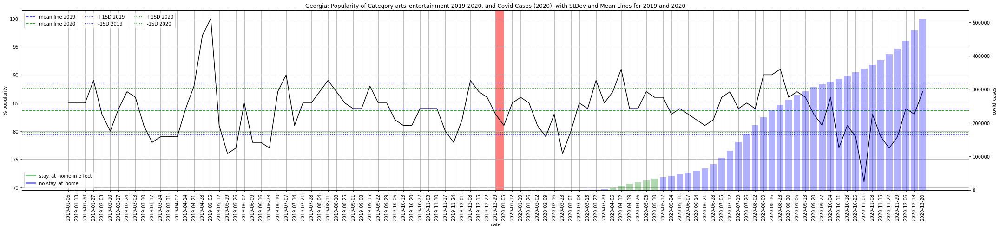

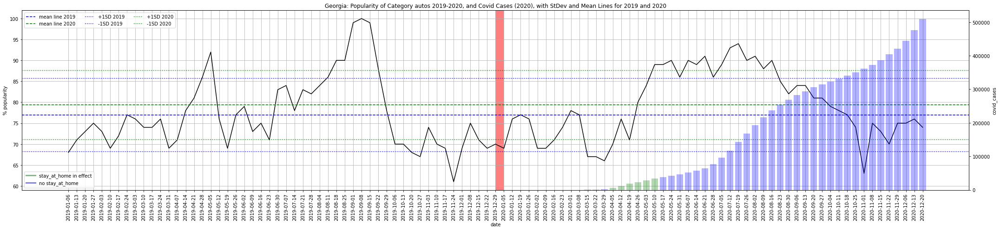

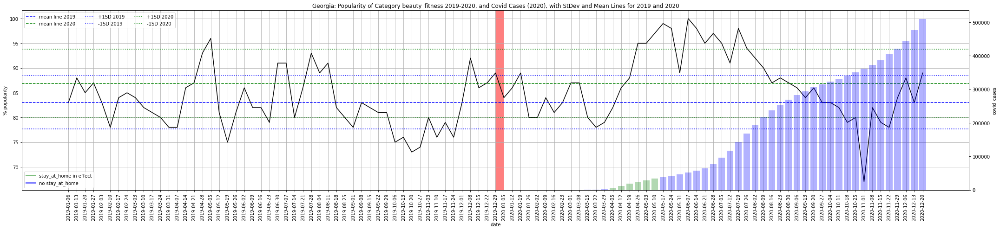

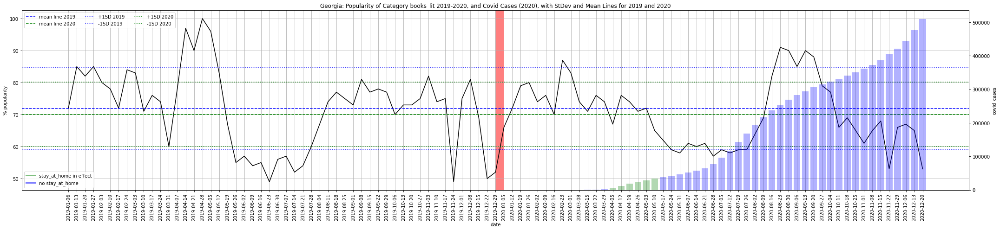

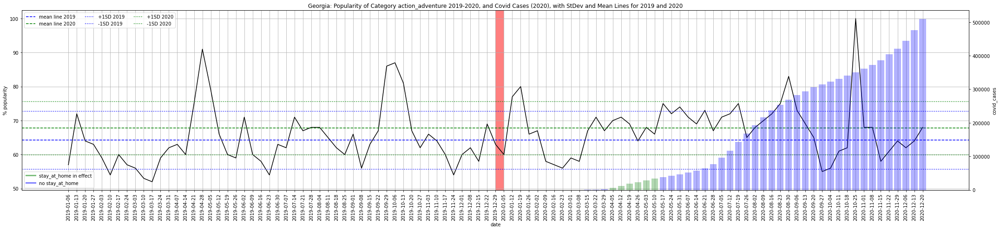

...

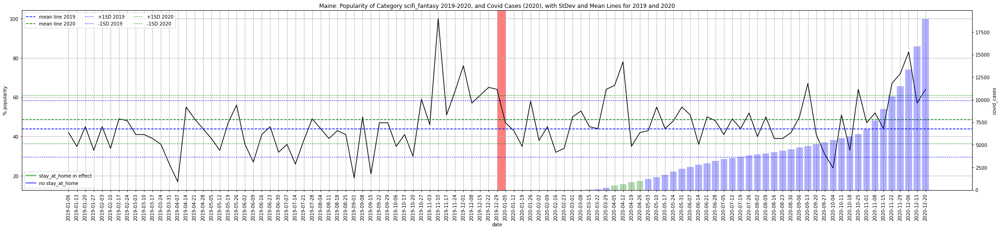

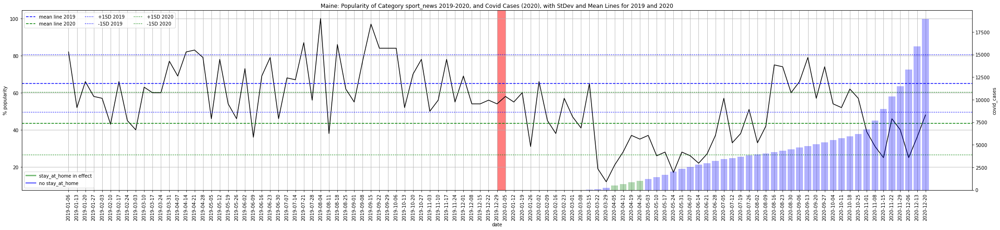

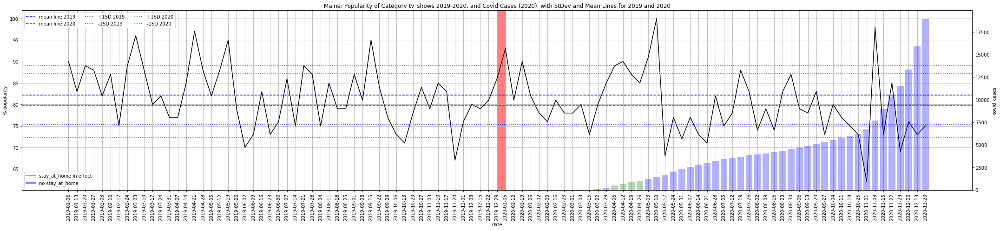

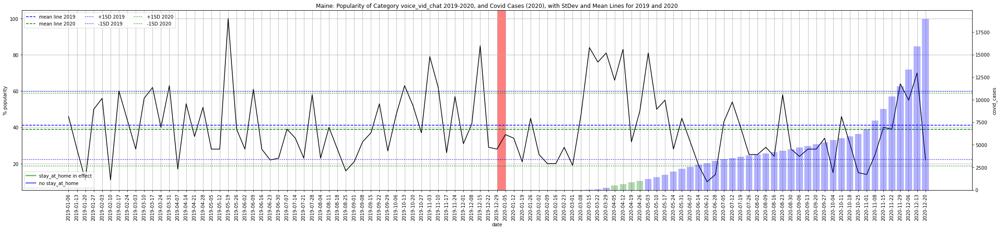

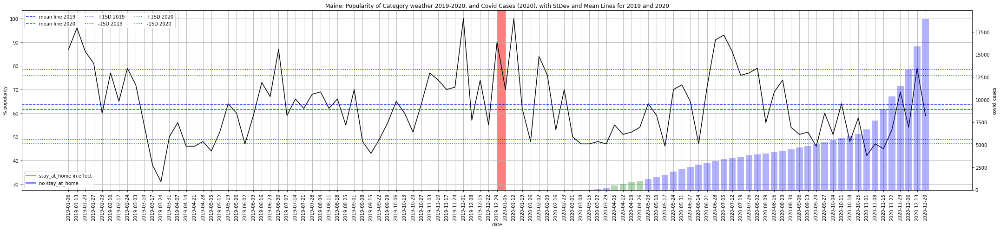

In [33]:
for x in range(10, 20):
    stdev_mean_graph_maker(x)